In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

from lib.graph_converter import GraphConverter
from lib.sumo_env import SimulationRecorder
from lib.macro import MacroMonitoring
import lib.quality_estimation as cmp
from lib.runners import OptimizationConfig, run_constant_control, run_optimization
import lib.derivative_free_optimizaiton as dfo

# Настройки системы

In [2]:
# SCENARIO_FOLDER = 'data/sumo/single_road'
# SCENARIO_FOLDER = 'data/sumo/road_merge'
# SCENARIO_FOLDER = 'data/sumo/cross_seq'
# SCENARIO_FOLDER = 'data/sumo/complex_grid'

# RESCO scenarios
# SCENARIO_FOLDER = 'data/sumo/arterial4x4'
# SCENARIO_FOLDER = 'data/sumo/grid4x4'
# SCENARIO_FOLDER = 'data/sumo/cologne1'
# SCENARIO_FOLDER = 'data/sumo/cologne3'
# SCENARIO_FOLDER = 'data/sumo/cologne8'
# SCENARIO_FOLDER = 'data/sumo/ingolstadt1'
SCENARIO_FOLDER = 'data/sumo/ingolstadt7'
# SCENARIO_FOLDER = 'data/sumo/ingolstadt21'


optimization_config = OptimizationConfig.parse_obj({
    'name': 'optimization-validation',
    # пути до конфигов симуляции|
    'sumo_config_path': f'{SCENARIO_FOLDER}/grid.sumocfg',
    'graph_path': f'{SCENARIO_FOLDER}/grid.net.xml',
    'fundamental_diagram_path': 'data/macro/fundamental_diagram_best.json',
    'plan_constraints_path': f'{SCENARIO_FOLDER}/plan_constraints.json',
    'stats_path': f'{SCENARIO_FOLDER}/output/stats.xml',
    # параметры симуляции
    'simulation_step': 0.5,
    'simulation_duration': 60 * 10,
    'time_window': 120,
    'graph_dx': 100,
    # параметры оптимизации
    'control_period': 60,
    'optimization_horizon': 120,
    'optimization_duration': 60,
    # 'optimization_duration': 60,
})

# Управление с фиксированным планом

Сбор данных

In [3]:
constant_control_result = run_constant_control(optimization_config, input_time_window=optimization_config.time_window)

 Retrying in 1 seconds


Step #58200.00 (2ms ~= 250.00*RT, ~41500.00UPS, TraCI: 12ms, vehicles TOT 479 ACT 83 BUF 0


### Расчет метрик

In [4]:
graph_converter = GraphConverter.from_dict(constant_control_result.graph)
macro_hist = MacroMonitoring.from_dict(constant_control_result.macro_hist)
recorder = SimulationRecorder.from_dict(constant_control_result.sumo_hist)

In [5]:
err_df = cmp.loops_error_metrics(recorder, macro_hist, time_window=optimization_config.time_window)

In [6]:
err_df.describe()

,intensity_rmse,velocity_rmse,density_rmse,intensity_medae,velocity_medae,density_medae,intensity_mae,velocity_mae,density_mae,intensity_re,velocity_re,density_re
count,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000
mean,0.059738,8.369702,0.013105,0.042789,6.006213,0.008042,0.046796,6.802630,0.009732,0.077993,0.445490,0.072988
std,0.043137,3.234356,0.017352,0.039306,5.571709,0.013931,0.035936,3.971084,0.013244,0.059894,0.260058,0.099331
min,0.000000,2.200252,0.000000,0.000000,0.364607,0.000000,0.000000,1.065353,0.000000,0.000000,0.069768,0.000000
25%,0.025440,5.804723,0.002301,0.011513,0.938977,0.001170,0.017448,3.293537,0.001761,0.029081,0.215687,0.013205
50%,0.054293,8.283303,0.005967,0.036127,3.320250,0.003576,0.043377,5.793560,0.004460,0.072294,0.379408,0.033453
75%,0.081829,10.946621,0.013612,0.060286,13.303388,0.009327,0.068606,10.381117,0.010378,0.114344,0.679837,0.077839
max,0.205678,13.966782,0.090882,0.208500,14.085988,0.111748,0.183610,13.945941,0.077060,0.306017,0.913290,0.577966


### Графики

#### Входные потоки

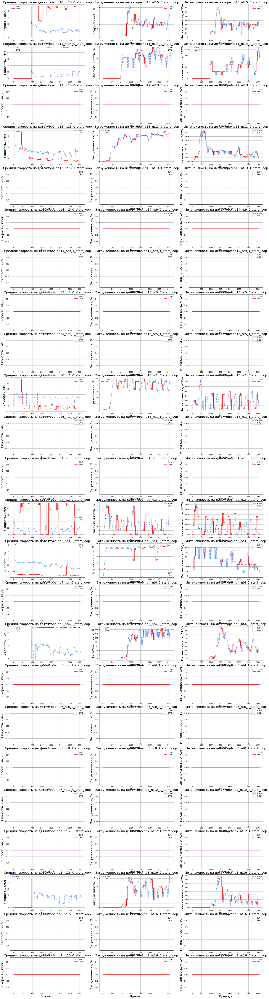

In [16]:
input_lane_ids = list(graph_converter.input_chains.keys())

fig, ax = plt.subplots(nrows=len(input_lane_ids), ncols=3, figsize=(30, 5 * len(input_lane_ids)))
for lane_idx, lane_id in enumerate(input_lane_ids):
    loop_id = f'{lane_id}_start_loop'
    if len(input_lane_ids) > 1:
        axes = ax[lane_idx]
    else:
        axes = ax

    recorder.plot_loop_data(loop_id, axes, color='cornflowerblue', linestyle='-.', label="SUMO")
    macro_hist.plot_input_data(lane_id, axes, color='r', label="GARZ")

#### Усредненные параметры потоков

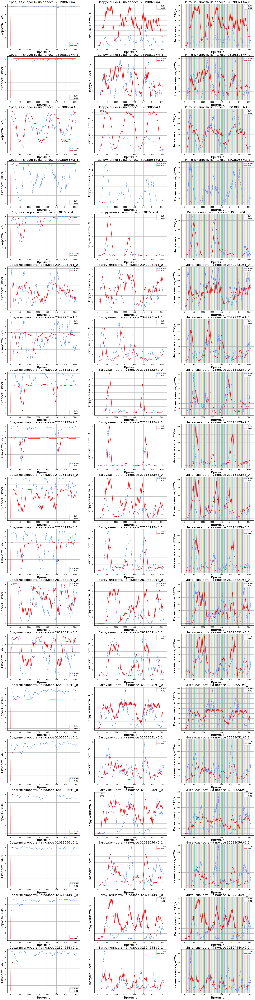

In [9]:
lane_ids = list(graph_converter.chains.keys())

fig, ax = plt.subplots(nrows=len(lane_ids), ncols=3, figsize=(30, 6.5 * len(lane_ids)))
for lane_idx, lane_id in enumerate(lane_ids):
    if len(lane_ids) > 1:
        axes = ax[lane_idx]
    else:
        axes = ax

    recorder.plot_lane_data(lane_id, axes, color='cornflowerblue', linestyle='-.', label="SUMO")
    macro_hist.plot_lane_mean_data(lane_id, axes, time_window=optimization_config.time_window, color='r', label="GARZ")
    # TODO: не хардкодить номер контроллера
    macro_hist.plot_phase_switches(1, axes[2])

#### Распределение параметров по полосе

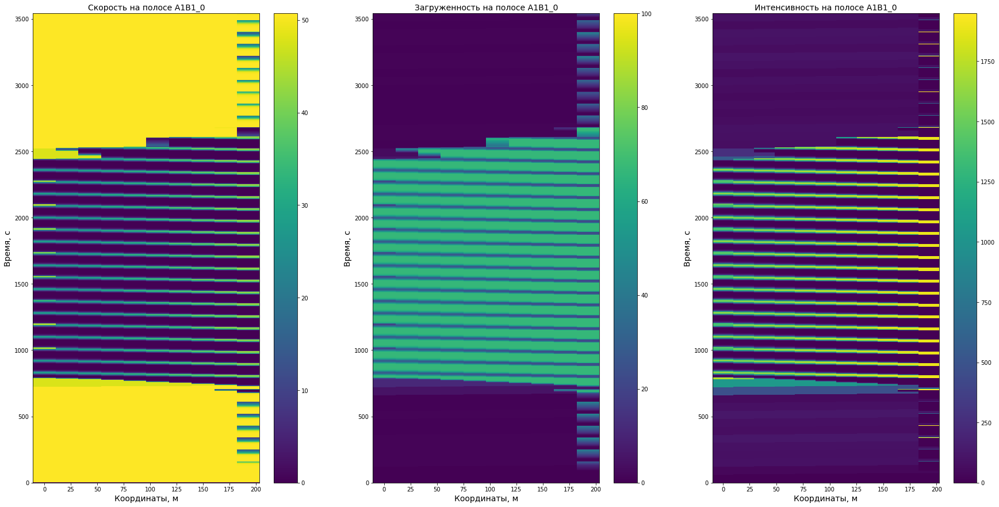

In [9]:
lane_id = 'A1B1_0'
# lane_id = 'B1C1_0'
# lane_id = 'C1D1_0'
fig, ax = plt.subplots(ncols=3, figsize=(30, 15))

macro_hist.heatmap_lane_velocity(lane_id, ax[0], need_title=True, need_legend=False)
macro_hist.heatmap_lane_occupancy(lane_id, ax[1], need_title=True, need_legend=False)
macro_hist.heatmap_lane_intensity(lane_id, ax[2], need_title=True, need_legend=False)

#### Показания детекторов в точке

In [18]:
recorder.loops.keys()

dict_keys(['np10_nt15_0_1_loop', 'np10_nt15_0_2_loop', 'np10_nt15_0_start_loop', 'np11_nt14_0_1_loop', 'np11_nt14_0_2_loop', 'np11_nt14_0_start_loop', 'np12_nt13_0_1_loop', 'np12_nt13_0_2_loop', 'np12_nt13_0_start_loop', 'np13_nt13_0_1_loop', 'np13_nt13_0_2_loop', 'np13_nt13_0_start_loop', 'np13_nt13_1_1_loop', 'np13_nt13_1_2_loop', 'np13_nt13_1_start_loop', 'np14_nt9_0_1_loop', 'np14_nt9_0_2_loop', 'np14_nt9_0_start_loop', 'np14_nt9_1_1_loop', 'np14_nt9_1_2_loop', 'np14_nt9_1_start_loop', 'np15_nt5_0_1_loop', 'np15_nt5_0_2_loop', 'np15_nt5_0_start_loop', 'np15_nt5_1_1_loop', 'np15_nt5_1_2_loop', 'np15_nt5_1_start_loop', 'np16_nt1_0_1_loop', 'np16_nt1_0_2_loop', 'np16_nt1_0_start_loop', 'np16_nt1_1_1_loop', 'np16_nt1_1_2_loop', 'np16_nt1_1_start_loop', 'np1_nt1_0_1_loop', 'np1_nt1_0_2_loop', 'np1_nt1_0_start_loop', 'np2_nt2_0_1_loop', 'np2_nt2_0_2_loop', 'np2_nt2_0_start_loop', 'np3_nt3_0_1_loop', 'np3_nt3_0_2_loop', 'np3_nt3_0_start_loop', 'np4_nt4_0_1_loop', 'np4_nt4_0_2_loop', 'np4_

In [17]:
lane_ids = list(graph_converter.chains.keys())
det_pos = [
    'start',
    'mid',
    'end',
]

fig, ax = plt.subplots(nrows=len(det_pos) * len(lane_ids), ncols=3, figsize=(40, 6.5 * len(det_pos) * len(lane_ids)))
for det_idx, detector_position in enumerate(det_pos):
    for lane_idx, lane_id in enumerate(lane_ids):
        idx = len(lane_ids) * det_idx + lane_idx
        if len(lane_ids) > 1:
            axes = ax[idx]
        else:
            axes = ax
            
        loop_id = f'{lane_id}_{detector_position}_loop'
        loop_position = recorder.loops[loop_id]['position']

        recorder.plot_loop_data(loop_id, axes, color='cornflowerblue', linestyle='-.', label='SUMO')
        macro_hist.plot_lane_position_data(lane_id, loop_position, axes, time_window=optimization_config.time_window, color='r', label="GARZ")
        # TODO: не хардкодить номер контроллера
        macro_hist.plot_phase_switches(1, axes[2])

KeyError: 'nt10_nt11_0_start_loop'

ValueError: Image size of 2880x168480 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 2880x168480 with 1080 Axes>

#### Давление на фазы

TypeError: 'AxesSubplot' object is not subscriptable

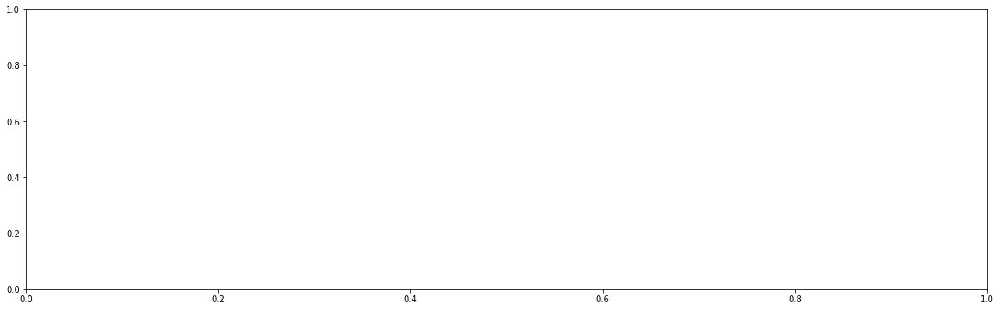

In [10]:
ctrls_ids = list(macro_hist.ctrl_phase_list.keys())
ctrls_ids.sort()
num_ctrl = len(ctrls_ids)

fig, ax = plt.subplots(nrows=num_ctrl, figsize=(20, num_ctrl*6))
for idx, ctrl_id in enumerate(ctrls_ids):
    macro_hist.plot_pressure(ctrl_id, ax[idx], need_title=True, need_legend=True) 
    macro_hist.plot_phase_switches(ctrl_id, ax[idx])

# Предиктивное управление

Сбор данных

In [7]:
optimization_result = run_optimization(
    optimization_config,
    input_time_window=optimization_config.time_window,
    optimizer=dfo.nelder_mead_optimization,
    # optimizer=dfo.powell_optimization,
    # optimizer=dfo.direct_optimization,
    # optimizer=lambda req: dfo.smoothed_adam(req, target=dfo.TargetScore.CritDensityScore),
    gui=False
)

 Retrying in 1 seconds
Start control: 74275.07295498
RUN OPTIMIZER: curr_time = 57660.0


/home/matrosik/voice_link/asudd-macro-rust/sumo-validation/lib/derivative_free_optimizaiton.py:245: OptimizeWarning: Initial guess is not within the specified bounds
  res = optimize.minimize(


OPTIMIZATION IS DONE: duration = 42.987033609999344
RUN OPTIMIZER: curr_time = 57720.0
OPTIMIZATION IS DONE: duration = 37.26921223200043
RUN OPTIMIZER: curr_time = 57780.0
OPTIMIZATION IS DONE: duration = 42.675712587006274
RUN OPTIMIZER: curr_time = 57840.0
OPTIMIZATION IS DONE: duration = 41.671225777987274
RUN OPTIMIZER: curr_time = 57900.0
OPTIMIZATION IS DONE: duration = 40.837645601000986
RUN OPTIMIZER: curr_time = 57960.0
OPTIMIZATION IS DONE: duration = 42.32142599199142


RUN OPTIMIZER: curr_time = 58020.0
OPTIMIZATION IS DONE: duration = 42.20905755199783
RUN OPTIMIZER: curr_time = 58080.0
OPTIMIZATION IS DONE: duration = 41.35236989799887
RUN OPTIMIZER: curr_time = 58140.0
OPTIMIZATION IS DONE: duration = 43.15107622600044
Step #58200.00 (2ms ~= 250.00*RT, ~50500.00UPS, TraCI: 10ms, vehicles TOT 479 ACT 101 BUF 


### Расчет метрик

In [8]:
opt_macro_hist = MacroMonitoring.from_dict(optimization_result.macro_hist)
opt_recorder = SimulationRecorder.from_dict(optimization_result.sumo_hist)
opt_err_df = cmp.loops_error_metrics(opt_recorder, opt_macro_hist, time_window=optimization_config.time_window)

In [9]:
opt_err_df.describe()

,intensity_rmse,velocity_rmse,density_rmse,intensity_medae,velocity_medae,density_medae,intensity_mae,velocity_mae,density_mae,intensity_re,velocity_re,density_re
count,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000
mean,0.059689,8.313528,0.012991,0.043032,5.789785,0.007632,0.046755,6.748743,0.009586,0.077924,0.441961,0.071895
std,0.043267,3.212817,0.016759,0.039623,5.470898,0.012828,0.036074,3.946178,0.012631,0.060124,0.258427,0.094734
min,0.000000,2.430826,0.000000,0.000000,0.301660,0.000000,0.000000,1.010876,0.000000,0.000000,0.066200,0.000000
25%,0.024382,5.801441,0.002395,0.011212,0.978242,0.001193,0.017059,3.311110,0.001826,0.028432,0.216838,0.013698
50%,0.055614,8.122790,0.005794,0.037400,3.117813,0.003663,0.042310,5.506359,0.004359,0.070517,0.360600,0.032694
75%,0.087034,10.931018,0.012835,0.062008,12.735536,0.009276,0.068641,10.407661,0.010448,0.114402,0.681576,0.078361
max,0.208735,13.966782,0.090350,0.218337,14.085988,0.111060,0.185984,13.945941,0.076881,0.309973,0.913290,0.576621


### Графики

#### Входные потоки

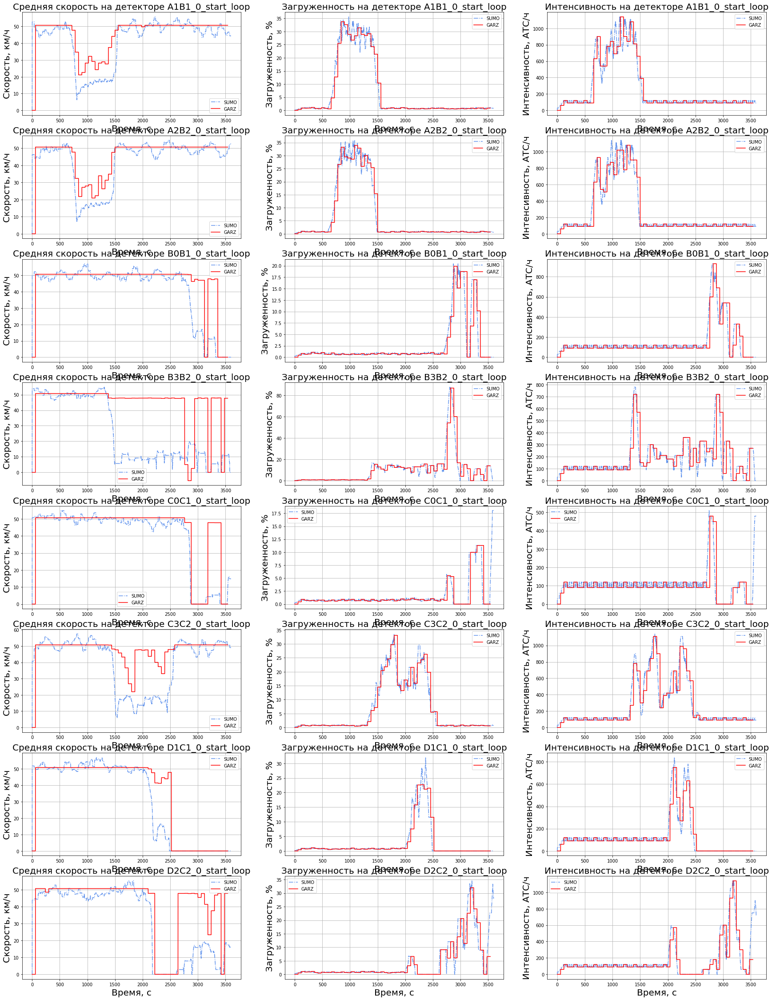

In [27]:
input_lane_ids = list(graph_converter.input_chains.keys())

fig, ax = plt.subplots(nrows=len(input_lane_ids), ncols=3, figsize=(30, 5 * len(input_lane_ids)))
for lane_idx, lane_id in enumerate(input_lane_ids):
    loop_id = f'{lane_id}_start_loop'
    if len(input_lane_ids) > 1:
        axes = ax[lane_idx]
    else:
        axes = ax

    opt_recorder.plot_loop_data(loop_id, axes, color='cornflowerblue', linestyle='-.', label="SUMO")
    opt_macro_hist.plot_input_data(lane_id, axes, color='r', label="GARZ")

#### Показания детекторов

In [16]:
lane_ids = list(graph_converter.chains.keys())
det_pos = [
    'start',
    'mid',
    'end',
]

fig, ax = plt.subplots(nrows=len(det_pos) * len(lane_ids), ncols=3, figsize=(40, 6.5 * len(det_pos) * len(lane_ids)))
for det_idx, detector_position in enumerate(det_pos):
    for lane_idx, lane_id in enumerate(lane_ids):
        idx = len(lane_ids) * det_idx + lane_idx
        if len(lane_ids) > 1:
            axes = ax[idx]
        else:
            axes = ax
            
        loop_id = f'{lane_id}_{detector_position}_loop'
        loop_position = recorder.loops[loop_id]['position']

        opt_recorder.plot_loop_data(loop_id, axes, color='cornflowerblue', linestyle='-.', label='SUMO')
        opt_macro_hist.plot_lane_position_data(lane_id, loop_position, axes, time_window=optimization_config.time_window, color='r', label="GARZ")
        # TODO: не хардкодить номер контроллера
        opt_macro_hist.plot_phase_switches(1, axes[2])

#### Давление на фазы

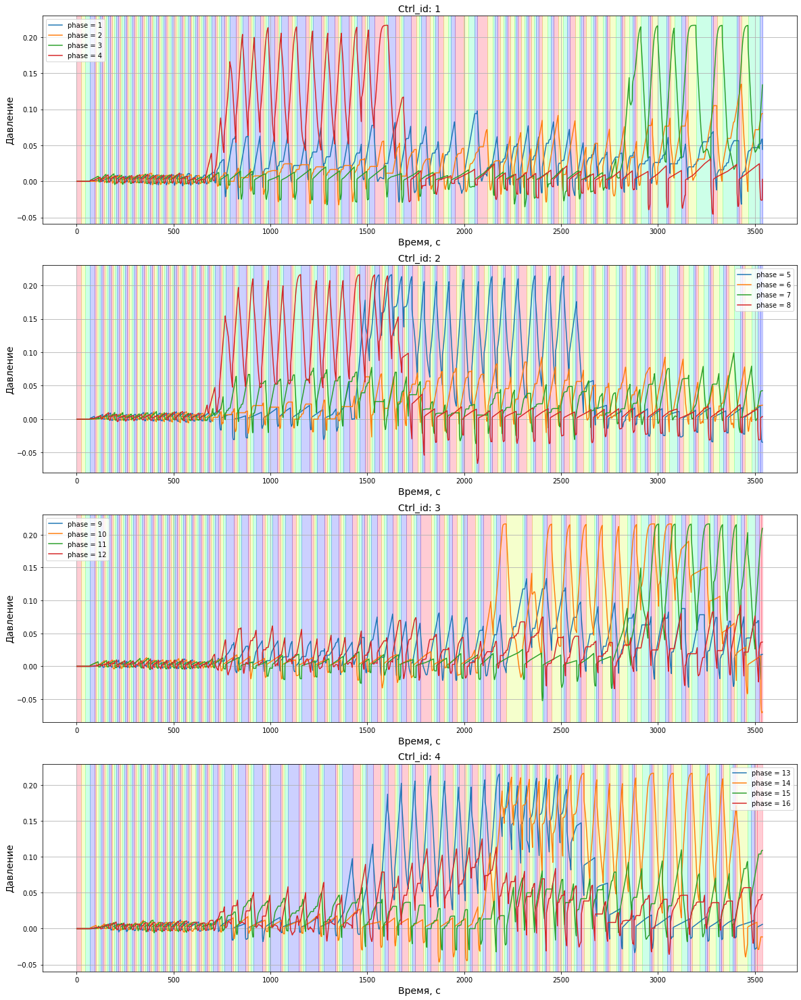

In [23]:
ctrls_ids = list(opt_macro_hist.ctrl_phase_list.keys())
ctrls_ids.sort()
num_ctrl = len(ctrls_ids)

fig, ax = plt.subplots(nrows=num_ctrl, figsize=(20, 6.5 * num_ctrl))
for idx, ctrl_id in enumerate(ctrls_ids):
    opt_macro_hist.plot_pressure(ctrl_id, ax[idx], need_title=True, need_legend=True) 
    opt_macro_hist.plot_phase_switches(ctrl_id, ax[idx])

## Сравнение статичного плана с управлением

### Количественная оценка эффективности управления

In [10]:
def calc_total_cars_output(recorder, output_lanes):
    total_cars_output = 0
    for lane_id in output_lanes:
        lane_output = np.cumsum(recorder.lanes.get(lane_id)['cars_output'])
        total_cars_output += lane_output
    return total_cars_output

In [11]:
output_lanes = list(graph_converter.output_chains.keys())
total_cars_output = calc_total_cars_output(recorder, output_lanes)
opt_total_cars_output = calc_total_cars_output(opt_recorder, output_lanes)

In [12]:
opt_cars_out = opt_total_cars_output[-1]
cars_out = total_cars_output[-1]
imp = (opt_cars_out - cars_out) / cars_out
print(f'Flow improvement before/after: {cars_out}/{opt_cars_out} ({imp * 100: .2f}%)')

travel_time = constant_control_result.stats.vehicle_trip_stats.duration
opt_travel_time = optimization_result.stats.vehicle_trip_stats.duration
travel_time_imp = (travel_time - opt_travel_time) / travel_time
print(f'Travel time improvement before/after: {travel_time}/{opt_travel_time} ({travel_time_imp * 100: .2f}%)')

speed = constant_control_result.stats.vehicle_trip_stats.speed
opt_speed = optimization_result.stats.vehicle_trip_stats.speed
speed_imp = (opt_speed - speed) / speed
print(f'Speed improvement before/after: {speed}/{opt_speed} ({speed_imp * 100: .2f}%)')

time_loss = constant_control_result.stats.vehicle_trip_stats.time_loss
opt_time_loss = optimization_result.stats.vehicle_trip_stats.time_loss
time_loss_imp = (time_loss - opt_time_loss) / time_loss
print(f'Time loss improvement before/after: {time_loss}/{opt_time_loss} ({time_loss_imp * 100: .2f}%)')

waiting_time = constant_control_result.stats.vehicle_trip_stats.waiting_time
opt_waiting_time = optimization_result.stats.vehicle_trip_stats.waiting_time
waiting_time_imp = (waiting_time - opt_waiting_time) / waiting_time
print(f'Waiting time improvement before/after: {waiting_time}/{opt_waiting_time} ({waiting_time_imp * 100: .2f}%)')

depart_delay = constant_control_result.stats.vehicle_trip_stats.depart_delay
opt_depart_delay = optimization_result.stats.vehicle_trip_stats.depart_delay
depart_delay_imp = (depart_delay - opt_depart_delay) / depart_delay
print(f'Depart delay improvement before/after: {depart_delay}/{opt_depart_delay} ({depart_delay_imp * 100: .2f}%)')

Flow improvement before/after: 395.0/378.0 (-4.30%)
Travel time improvement before/after: 87.87/89.34 (-1.67%)
Speed improvement before/after: 6.3/6.29 (-0.16%)
Time loss improvement before/after: 49.72/51.15 (-2.88%)
Waiting time improvement before/after: 29.74/30.92 (-3.97%)
Depart delay improvement before/after: 3.33/3.19 ( 4.20%)


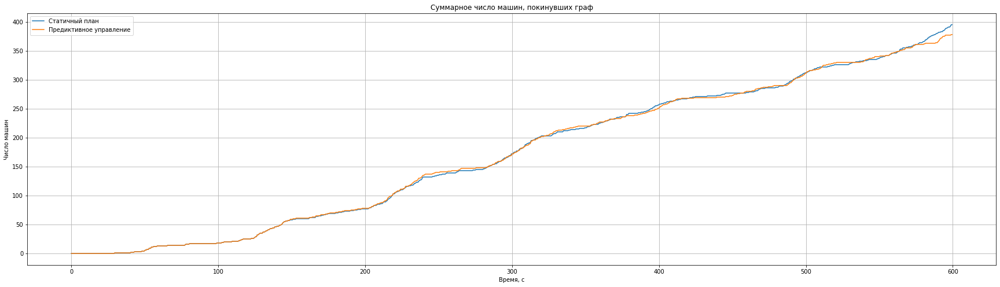

In [13]:
fig, ax = plt.subplots(figsize=(30, 8))
time = np.array(opt_recorder.time)
ax.plot(time, total_cars_output, label="Статичный план")
ax.plot(time, opt_total_cars_output, label="Предиктивное управление")
ax.set_title("Суммарное число машин, покинувших граф")
ax.set_ylabel("Число машин")
ax.set_xlabel("Время, с")
ax.legend()
ax.grid()

### Графики

Сравнение статического плана с пердиктивным управлением. <br>
На графиках усредненные параметры потоков, собранные в SUMO

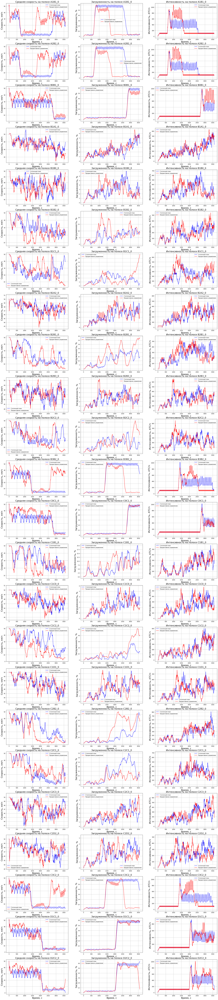

In [ ]:
# lane_ids = [
#     'A1B1_0',
#     # 'B1B2_0',
#     'B1C1_0',
#     'C1D1_0',
# ]
lane_ids = list(graph_converter.chains.keys())

fig, ax = plt.subplots(nrows=len(lane_ids), ncols=3, figsize=(30, 6 * len(lane_ids)))
for lane_idx, lane_id in enumerate(lane_ids):
    loop_id = f'{lane_id}_mid_loop'
    if len(lane_ids) > 1:
        axes = ax[lane_idx]
    else:
        axes = ax

    recorder.plot_lane_data(lane_id, axes, color='b', linestyle='-', need_legend=True, fontsize=18, label='Статичный план')
    opt_recorder.plot_lane_data(lane_id, axes, color='r', linestyle='-', need_legend=True, fontsize=18, label='Предиктивное управление')

### Динамика оптимизации

In [26]:
opt_responses = optimization_result.optimization_responses
response_idx = 10
times = opt_responses[response_idx].local_search_result.times
scores = opt_responses[response_idx].local_search_result.scores

AttributeError: 'NoneType' object has no attribute 'times'

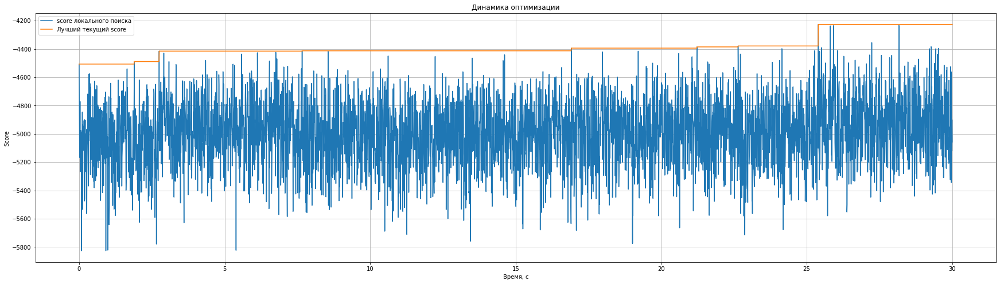

In [18]:
fig, ax = plt.subplots(figsize=(30, 8))
time = np.array(times)
scores = pd.Series(scores)
best_scores = scores.cummax()

ax.plot(time, scores, label="score локального поиска")
ax.plot(time, best_scores, label="Лучший текущий score")

ax.set_title("Динамика оптимизации")
ax.set_ylabel("Score")
ax.set_xlabel("Время, с")
ax.legend()
ax.grid()

## Графики для статьи

In [18]:
graph_converter.controllers

{'247379907': {'controller_id': 1,
  'phases': [{'phase_id': 1,
    'phase_number': 1,
    'green_links': [78, 79, 80, 81, 82, 69, 70, 71, 72, 73]},
   {'phase_id': 2, 'phase_number': 2, 'green_links': [81, 82, 72, 73]},
   {'phase_id': 3,
    'phase_number': 3,
    'green_links': [83, 84, 85, 86, 74, 75, 76, 77]},
   {'phase_id': 4, 'phase_number': 4, 'green_links': [85, 86, 76, 77]}]},
 '252017285': {'controller_id': 2,
  'phases': [{'phase_id': 5,
    'phase_number': 1,
    'green_links': [36, 37, 38, 39, 28, 29, 30, 31]},
   {'phase_id': 6,
    'phase_number': 2,
    'green_links': [32, 33, 34, 35, 24, 25, 26, 27]}]},
 '256201389': {'controller_id': 3,
  'phases': [{'phase_id': 7,
    'phase_number': 1,
    'green_links': [101, 102, 103, 107, 108, 109]},
   {'phase_id': 8, 'phase_number': 2, 'green_links': [103, 108, 109]},
   {'phase_id': 9, 'phase_number': 3, 'green_links': [104, 105, 106, 101]}]},
 '26110729': {'controller_id': 4,
  'phases': [{'phase_id': 10,
    'phase_number'

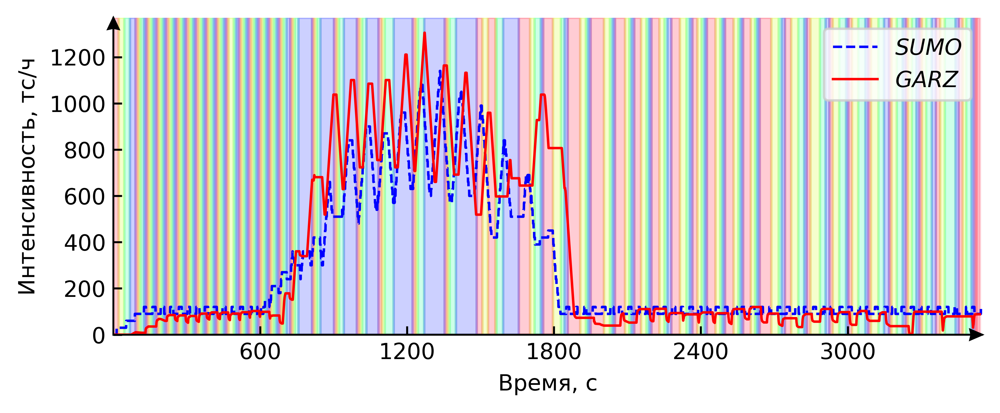

In [23]:
import matplotlib.pyplot as plt
import matplotlib.font_manager as font_manager

def arrowed_spines(ax):
    xmin, xmax = ax.get_xlim() 
    ymin, ymax = ax.get_ylim()

    # manual arrowhead width and length
    hw = 45 
    hl = 50
    lw = 0.7 # axis line width
    ohg = 0.1 # arrow overhang

    # draw x and y axis
    ax.arrow(xmin, 0, xmax, 0., fc='k', ec='k', lw = lw, 
             head_width=hw, head_length=hl, overhang = ohg, 
             length_includes_head= True, clip_on = False) 

    ax.arrow(0, ymin, 0., ymax, fc='k', ec='k', lw = lw, 
             head_width=hw, head_length=hl, overhang = ohg, 
             length_includes_head= True, clip_on = False)


lane_id = 'A1B1_0'
loop_id = f'{lane_id}_end_loop'
# lane_id = '-28675510#0_0'
# loop_id = f'{lane_id}_1_loop'
loop_position = recorder.loops[loop_id]['position']

axis_font = {'fontname':'Arial', 'size':'9'}

cm = 1. / 2.54
fig, ax = plt.subplots(figsize=(16*cm, 6.*cm), dpi=600)
opt_recorder.plot_loop_intensity(loop_id, ax, need_title=False, color='blue', linestyle='--', lw=1., label='SUMO')
opt_macro_hist.plot_lane_position_intensity(lane_id, loop_position, ax, time_window=optimization_config.time_window, color='r', lw=1.,label="GARZ")
opt_macro_hist.plot_phase_switches(2, ax)

ax.grid(False)
ax.set_xlim([0,3550])
ax.set_ylim(0)
ax.set_xlabel("Время, с", **axis_font)
ax.set_ylabel("Интенсивность, тс/ч", **axis_font)

font = font_manager.FontProperties(family='Arial',
                                   weight='normal',
                                   style='italic', size=9)
ax.legend(prop=font)

ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_linewidth(0.7)
ax.spines['bottom'].set_linewidth(0.7)
ax.tick_params(axis="both",direction="in", pad=3, labelsize=9)
ax.set_xticks([600, 1200, 1800, 2400, 3000])

arrowed_spines(ax)

plt.show()

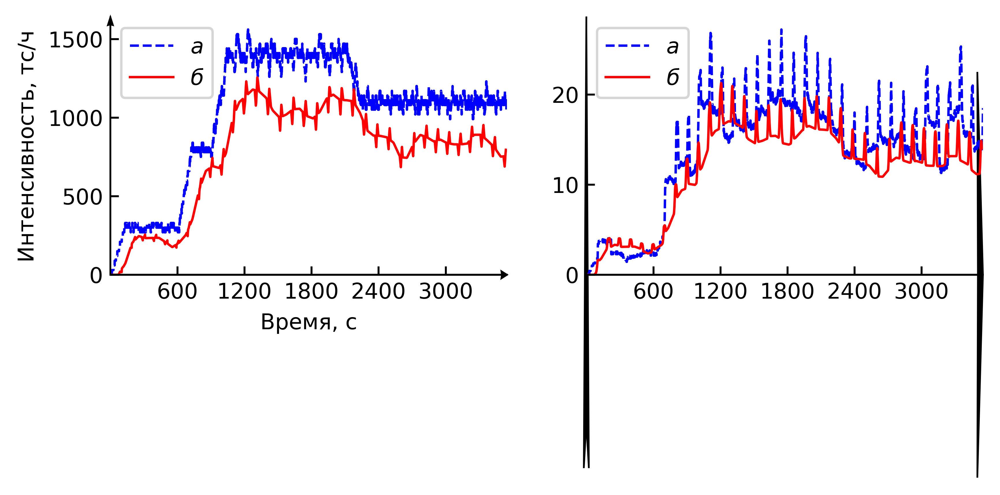

In [ ]:
lane_id = 'A1B1_0'
loop_id = f'{lane_id}_end_loop'
loop_position = recorder.loops[loop_id]['position']

axis_font = {'fontname':'Arial', 'size':'9'}

cm = 1. / 2.54
fig, axes = plt.subplots(ncols=2, figsize=(16.5*cm, 5.*cm), dpi=600)

opt_recorder.plot_loop_intensity(loop_id, axes[0], need_title=False, color='blue', linestyle='--', lw=1., label='а')
opt_macro_hist.plot_lane_position_intensity(lane_id, loop_position, axes[0], time_window=optimization_config.time_window, color='r', lw=1.,label="б")

opt_recorder.plot_loop_occupancy(loop_id, axes[1], need_title=False, color='blue', linestyle='--', lw=1., label='а')
opt_macro_hist.plot_lane_position_occupancy(lane_id, loop_position, axes[1], time_window=optimization_config.time_window, color='r', lw=1.,label="б")
# opt_macro_hist.plot_phase_switches(1, axes[0])

axes[0].set_xlabel("Время, с", **axis_font)
axes[0].set_ylabel("Интенсивность, тс/ч", **axis_font)

font = font_manager.FontProperties(
    family='Arial',
    weight='normal',
    style='italic',
    size=9
)
axes[1].legend(prop=font)

for ax in axes:
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    ax.spines['left'].set_linewidth(0.7)
    ax.spines['bottom'].set_linewidth(0.7)

    ax.grid(False)
    ax.set_xlim([0,3550])
    ax.set_ylim(0)

    ax.tick_params(axis="both",direction="in", pad=3, labelsize=9)
    ax.set_xticks([600, 1200, 1800, 2400, 3000])
    arrowed_spines(ax)
    ax.legend(prop=font)

plt.show()